# Project 1 - object removal

In this project we will try to remove moving objects from the series of images. Basically the task is to recognize regions of the images which are changing between the frames and replace them with static background. The final result should be one image containing only background elements.

## Imports

In [ ]:
import cv2
import numpy as np
import PIL
from PIL import Image 

In [ ]:
def open(img):
    return cv2.dilate(cv2.erode(img, np.ones((4,4))), np.ones((4,4)))

def close(img, kernel_size):
    kernel = np.ones(kernel_size)
    return cv2.erode(cv2.dilate(img, kernel), kernel)

def dilate(img, kernel_size):
    kernel = np.ones(kernel_size)
    return cv2.dilate(img, kernel)

def erode(img, kernel_size):
    kernel = np.ones(kernel_size)
    return cv2.erode(img, kernel)

def proper_open(img):
    to_compare = close(open(close(img)))
    stack = np.stack((img, to_compare))
    return np.min(stack, axis=0)

def proper_close(img):
    to_compare = open(close(open(img)))
    stack = np.stack((img, to_compare))
    return np.max(stack, axis=0)

def automedian_filter(img):
    to_compare = proper_open(img)
    stack = np.stack((img, to_compare))
    return np.max(stack, axis=0)


In [76]:

def imshow1(img):
    img = img.clip(0, 255).astype("uint8")
    if img.ndim == 3:
        if img.shape[2] == 4:
            img = cv2.cvtColor(img, cv2.COLOR_BGRA2RGBA)
        else:
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    display(PIL.Image.fromarray(img))

In [ ]:
def imshow(img):
    img = img.clip(0, 255).astype("uint8")
    
    # Convert color spaces if needed
    if img.ndim == 3:
        if img.shape[2] == 4:
            img = cv2.cvtColor(img, cv2.COLOR_BGRA2RGBA)
        else:
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # Resize the image
    img_pil = PIL.Image.fromarray(img)
    img_pil.thumbnail((500, 500), PIL.Image.Resampling.LANCZOS)
    
    # Display the resized image directly
    display(img_pil)

The data we base our experiments on is a series of three images of street traffic here the task is obviously to remove the cars.

In [ ]:
img1 = cv2.imread('DJI_20231031123737_0028_W.JPG')
img2 = cv2.imread('DJI_20231031123813_0040_W.JPG')
img3 = cv2.imread('DJI_20231031123834_0047_W.JPG')
print(img1.shape)
print(img2.shape)
print(img3.shape)
imshow(img1)
#imshow(img2)
#imshow(img3)

# Pixel average and median

First we will try the most basic approach: median and average filtering. The results are effects of conducting those basic operations on corresponding pixels from the three images. 

We can see that the results of the average filter are rather poor. The cars from all the images are still visible but they are now partially transparent. If the number of the images to process was much higher the influence of the single image would probably be not as significant. But with only 3 the impact of each easily noticeable. 

The median filter produced better results than the average. For most of the regions the cars were successfully removed however there were some problematic sections. Those sections are the parts of the image were two cars from different frames are located in the same position. Locating those regions on concrete images may be the key to solving the problem.

In [ ]:
stacked_img = np.stack((img1, img2, img3))
average_img = np.average(stacked_img, axis=0)
median_img = np.median(stacked_img, axis=0)
print("average:")
imshow(average_img)
print("median:")
imshow(median_img)

# Sobel

In this section we will try to locate the objects on the images using sobel filter. Based on the places were the edges are detected we will hopefully be able to locate the whole objects. Using that information it will be possible to create masks used to later filtering out the moving objects.

We can see that both the cars and surrounding objects: trees, buildings road etc were detected by the algorithm therefore the first task is to filter out only the cars. 

First attempt was to remove other objects by using the minimal value among the three sobel pictures. By that way the places were the static objects are located should remain present while cars should be deleted because they will be replaced by the pixels with lower value from the image where there is no edge in that place. Such an image containing only the edges of the trees can be later subtracted from each of the sobel images leaving only the cars on it. 

The image containing min sobel values indeed seems not to have any cars.

In [ ]:
img1_grayscale = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2_grayscale = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
img3_grayscale = cv2.cvtColor(img3, cv2.COLOR_BGR2GRAY)

img1_sobel = np.abs(cv2.Sobel(img1_grayscale, cv2.CV_64F, 1, 0, ksize=3))
img2_sobel = np.abs(cv2.Sobel(img2_grayscale, cv2.CV_64F, 1, 0, ksize=3))
img3_sobel = np.abs(cv2.Sobel(img3_grayscale, cv2.CV_64F, 1, 0, ksize=3))

stacked_sobel = np.stack((img1_sobel, img2_sobel, img3_sobel))
sobel_min = np.min(stacked_sobel, axis=0)
sobel_median = np.median(stacked_sobel, axis=0)

imshow(img1_sobel)
imshow(img2_sobel)
imshow(img3_sobel)
imshow(sobel_min)
imshow(sobel_median)

In order to cover the whole cars filtered sobel edge images needed to be additionally dilated. 

In [ ]:



sobel_min[sobel_min < 2] = 0
reduced = img1_sobel - 5 * sobel_min
open_result1 = (open(reduced))
binarized1 = (open_result1 > 0).astype(np.uint8) * 255

reduced = img2_sobel - 5 * sobel_min
open_result2 = (open(reduced))
binarized2 = (open_result2 > 0).astype(np.uint8) * 255

reduced = img3_sobel - 5 * sobel_min
open_result3 = (open(reduced))
binarized3 = (open_result3 > 0).astype(np.uint8) * 255

for i in range(3):
    binarized1 = cv2.dilate(binarized1, np.ones((20,20)))
    binarized2 = cv2.dilate(binarized2, np.ones((20,20)))
    binarized3 = cv2.dilate(binarized3, np.ones((20,20)))

for img, binarized in zip([img1, img2, img3], [binarized1, binarized2, binarized3]):
    imshow(img)
    imshow(binarized)
    stack = np.stack((img, np.repeat(binarized[:,: ,np.newaxis], 3, axis=2)))

    imshow(np.average(stack, axis=0))


Using minimal value and filtering it turned out not to meet the expectations. The cars were discovered but the most crucial parts of the image were marked on all three frames. It makes us unable to properly filter out the object in that regions. It is probably because sobel filter can also produce small values around the edges so during the calculation of the minimal value each image left some artifacts in the places were the cars are located.

In [ ]:
stack_binarized = np.stack((binarized1, binarized2, binarized3))
min_binarized = np.min(stack_binarized, axis=0)
imshow(min_binarized)
for img, binarized in zip([img1, img2, img3], [min_binarized, min_binarized, min_binarized]):
    stack = np.stack((img, np.repeat(binarized[:,: ,np.newaxis], 3, axis=2)))

    imshow(np.average(stack, axis=0))

A second approach was to use each of the fames both as a source of information and a mask for filtering out the information. We also used stronger dilation in filtering process. Each edge representation was removed from the other in order for only cars to remain. Filtered edge representations were then processed by the series of erosions and dilations to finally obtain the masks for the cars.

In [ ]:
sobel1_modified = (img1_sobel > 100).astype(np.uint8) * 255
sobel2_modified = (img2_sobel > 500).astype(np.uint8) * 255
sobel3_modified = (img3_sobel > 100).astype(np.uint8) * 255


kernel = np.ones((3, 3), dtype=np.uint8)

sobel1_modified = cv2.dilate(sobel1_modified, kernel)
sobel2_modified = cv2.dilate(sobel2_modified, kernel)
sobel3_modified = cv2.dilate(sobel3_modified, kernel)

imshow(sobel1_modified)
imshow(sobel2_modified)
imshow(sobel3_modified)

img1_sobel_copy = img1_sobel.copy()
img1_sobel_copy[sobel2_modified.astype(np.bool_)] = 0
img1_sobel_copy[sobel3_modified.astype(np.bool_)] = 0
img1_sobel_copy = (img1_sobel_copy > 255).astype(np.uint8) * 255

img2_sobel_copy = img2_sobel.copy()
img2_sobel_copy[sobel1_modified.astype(np.bool_)] = 0
img2_sobel_copy[sobel3_modified.astype(np.bool_)] = 0
img2_sobel_copy = (img2_sobel_copy > 230).astype(np.uint8) * 255


img3_sobel_copy = img3_sobel.copy()
img3_sobel_copy[sobel1_modified.astype(np.bool_)] = 0
img3_sobel_copy[sobel2_modified.astype(np.bool_)] = 0
img3_sobel_copy = (img3_sobel_copy > 200).astype(np.uint8) * 255

imshow(img1_sobel_copy)
imshow(img2_sobel_copy)
imshow(img3_sobel_copy)

if True:
    kernel = np.ones((2, 2), dtype=np.uint8)

    img1_sobel_copy = cv2.dilate(img1_sobel_copy, kernel)
    img2_sobel_copy = cv2.dilate(img2_sobel_copy, kernel)
    img3_sobel_copy = cv2.dilate(img3_sobel_copy, kernel)

    kernel = np.ones((3, 3), dtype=np.uint8)

    img1_sobel_copy = cv2.erode(img1_sobel_copy, kernel)
    img2_sobel_copy = cv2.erode(img2_sobel_copy, kernel)
    img3_sobel_copy = cv2.erode(img3_sobel_copy, kernel)

    if True:
        kernel = np.ones((130, 130), dtype=np.uint8)

        img1_sobel_copy = cv2.dilate(img1_sobel_copy, kernel)


        kernel = np.ones((75, 75), dtype=np.uint8)
        img1_sobel_copy = cv2.erode(img1_sobel_copy, kernel)



        


        kernel = np.ones((100, 100), dtype=np.uint8)
        img2_sobel_copy = cv2.dilate(img2_sobel_copy, kernel)
        kernel = np.ones((45, 45), dtype=np.uint8)
        img2_sobel_copy = cv2.erode(img2_sobel_copy, kernel)
        kernel = np.ones((7, 7), dtype=np.uint8)
        img2_sobel_copy = cv2.erode(img2_sobel_copy, kernel)


        kernel = np.ones((20, 20), dtype=np.uint8)
        img3_sobel_copy = cv2.dilate(img3_sobel_copy, kernel)
        img3_sobel_copy = cv2.dilate(img3_sobel_copy, kernel)
        img3_sobel_copy = cv2.dilate(img3_sobel_copy, kernel)

        kernel = np.ones((20, 20), dtype=np.uint8)
        img3_sobel_copy = cv2.dilate(img3_sobel_copy, kernel)
        
        
        kernel = np.ones((40, 40), dtype=np.uint8)
        img3_sobel_copy = cv2.erode(img3_sobel_copy, kernel)

        kernel = np.ones((10, 10), dtype=np.uint8)
        img3_sobel_copy = cv2.erode(img3_sobel_copy, kernel)


for img, binarized in zip([img1, img2, img3], [img1_sobel_copy, img2_sobel_copy, img3_sobel_copy]):
    stack = np.stack((img, np.repeat(binarized[:,: ,np.newaxis], 3, axis=2)))

    imshow(np.average(stack, axis=0))

This time the final result is much better. Most of the places were properly marked only on the images with the cars in those places. Some of noise and other objects were marked as well but no such discoveries overlap on all three images. The problem is only one small region which contains cars in some of its part in all three regions. The region was marked on all three frames therefore filtering for it still can not be done.

In [ ]:
mask_min = np.stack((img1_sobel_copy, img2_sobel_copy, img3_sobel_copy))
mask_min = np.min(mask_min, axis=0)

for img, binarized in zip([img1, img2, img3], [mask_min, mask_min, mask_min]):
    stack = np.stack((img, np.repeat(binarized[:,: ,np.newaxis], 3, axis=2)))

    imshow(np.average(stack, axis=0))

Based on obtained masks we construct the new image. Regions that are not covered by any mask will still be obtained using median filter. Those covered by the one mask will use the average of the two remaining images. Covered by two masks will use the one uncovered region. The one problematic region will be filled using inpaint function.

In [ ]:
img1_modified = img1.copy()
img2_modified = img2.copy()
img3_modified = img3.copy()

img12_modified = np.stack((img1, img2))
img13_modified = np.stack((img1, img3))
img23_modified = np.stack((img2, img3))
img12_modified = np.average(img12_modified, axis=0)
img13_modified = np.average(img13_modified, axis=0)
img23_modified = np.average(img23_modified, axis=0)

img123_modified = np.stack((img1, img2, img3))
img123_modified = np.median(img123_modified, axis=0)

mask1 = img1_sobel_copy.astype(np.bool_)
mask2 = img2_sobel_copy.astype(np.bool_)
mask3 = img3_sobel_copy.astype(np.bool_)

mask12 = mask1 & mask2
mask13 = mask1 & mask3
mask23 = mask2 & mask3
 
mask123 = mask12 & mask3

img1_modified[mask1 | ~mask2 | ~mask3] = 0
img2_modified[mask2 | ~mask1 | ~mask3] = 0
img3_modified[mask3 | ~mask1 | ~mask2] = 0
img12_modified[mask1 | mask2 | ~mask3] = 0
img13_modified[mask1 | ~mask2 | mask3] = 0
img23_modified[~mask1 | mask2 | mask3] = 0

img123_modified[mask1 | mask2 | mask3] = 0

final = np.stack((img1_modified, img2_modified, img3_modified, img12_modified, img13_modified, img23_modified, img123_modified))
final = np.sum(final, axis=0)
imshow(img12_modified)
imshow(img13_modified)
imshow(img23_modified)
imshow(final)

final = cv2.inpaint(final.astype(np.uint8), mask123.astype(np.uint8), 20, cv2.INPAINT_NS)
imshow(final)

## Inpaint

In that section we wanted to check how well the cv2 inpaint function would behave. 

In [ ]:

sobel_min[sobel_min < 2] = 0

reduced = img1_sobel - 5 * sobel_min
open_result1 = (open(reduced))
binarized1 = (open_result1 > 0).astype(np.uint8) * 255


reduced = img2_sobel - 5 * sobel_min
open_result2 = (open(reduced))
binarized2 = (open_result2 > 0).astype(np.uint8) * 255

reduced = img3_sobel - 5 * sobel_min
open_result3 = (open(reduced))
binarized3 = (open_result3 > 0).astype(np.uint8) * 255

for i in range(3):
    binarized1 = cv2.dilate(binarized1, np.ones((20,20)))
    binarized2 = cv2.dilate(binarized2, np.ones((20,20)))
    binarized3 = cv2.dilate(binarized3, np.ones((20,20)))



First we use the same masks as obtained in previous experiments based on sobel filter processing. We can see that this approach does not give satisfactory results. The covered regions are too big for inpaint function to properly deduce the correct values of pixels. The image becomes blurry.

In [ ]:

images=[]
for img, mask in zip([img1,img2,img3], [binarized1,binarized2, binarized3]):
    images.append(cv2.inpaint(img, mask, inpaintRadius=3, flags=cv2.INPAINT_TELEA))
stacked_img=np.stack(images)
for x in images:
    imshow(x)
inpainted_image = np.median(stacked_img, axis=0)
imshow(inpainted_image)

In [ ]:
def Automedian(img, s):
  return np.maximum(cv2.morphologyEx(cv2.morphologyEx(cv2.morphologyEx(img.copy(), cv2.MORPH_OPEN, s), cv2.MORPH_CLOSE, s), cv2.MORPH_OPEN, s),np.minimum(cv2.morphologyEx(cv2.morphologyEx(cv2.morphologyEx(img.copy(), cv2.MORPH_CLOSE, s), cv2.MORPH_OPEN, s), cv2.MORPH_CLOSE, s), img))


In [ ]:
def open(img,s):
    return cv2.dilate(cv2.erode(img, s), s)

def close(img,s):
    return cv2.erode(cv2.dilate(img, s), s)

def proper_open(img,s):
    to_compare = close(open(close(img,s),s),s)
    stack = np.stack((img, to_compare))
    return np.min(stack, axis=0)

def proper_close(img,s):
    to_compare = open(close(open(img,s),s),s)
    stack = np.stack((img, to_compare))
    return np.max(stack, axis=0)


## Absolute difference

Here we wanted to use the absolute difference in image brightness. The difference is calculated in respect to the image obtained in median merge. That way only places where the cars are present should be found. We can see that the detection of cars was quite well. We combine the three masks and use inpaint function to fill the covered regions. The quality of the result is not very high. It was still do difficult for inpaint to fill the gaps properly. The masks did not fully cover the objects too. However the most important thing we have learned from that experiment is that the absolute difference can be a good way of mask detection.

In [ ]:



gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
gray3 = cv2.cvtColor(img3, cv2.COLOR_BGR2GRAY)

stacked_img = np.stack((img1, img2, img3))

median_img = np.median(stacked_img, axis=0).astype(np.uint8)
gray4=cv2.cvtColor(median_img, cv2.COLOR_BGR2GRAY)
# Compute absolute differences between consecutive frames
diff1 = cv2.absdiff(gray1, gray4)
diff2 = cv2.absdiff(gray2, gray4)
diff3 = cv2.absdiff(gray3, gray4)
# Threshold the differences to get a binary mask
_, thresh1 = cv2.threshold(diff1, 70, 255, cv2.THRESH_BINARY)
_, thresh2 = cv2.threshold(diff2, 70, 255, cv2.THRESH_BINARY)
_, thresh3 = cv2.threshold(diff3, 70, 255, cv2.THRESH_BINARY)
s=np.ones((5,5))




# Combine the binary masks
combined_mask = cv2.bitwise_or(cv2.bitwise_or(thresh1, thresh2), thresh3)
    # Apply morphological operations to improve the mask
kernel = np.ones((3,3), np.uint8)

combined_mask = Automedian(combined_mask, kernel)

combined_mask=proper_open(combined_mask, np.ones((3,3)))
combined_mask=Automedian(combined_mask, np.ones((21,21)))

imshow(combined_mask)
# Inpainting to fill in the gaps
inpainted_image1 = cv2.inpaint(median_img.astype(np.uint8), combined_mask, inpaintRadius=31, flags=cv2.INPAINT_TELEA)


img=inpainted_image1
imshow(img)

Here we use the masks obtained from the absolute difference as individual and construct new image based on which regions uncovered regions of each mask. The result is once again not satisfactory because the masks do not cover the whole objects.

In [ ]:

gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
gray3 = cv2.cvtColor(img3, cv2.COLOR_BGR2GRAY)

stacked_img = np.stack((img1, img2, img3))

median_img = np.median(stacked_img, axis=0).astype(np.uint8)
gray4=cv2.cvtColor(median_img, cv2.COLOR_BGR2GRAY)
# Compute absolute differences between consecutive frames
diff1 = cv2.absdiff(gray1, gray4)
diff2 = cv2.absdiff(gray2, gray4)
diff3 = cv2.absdiff(gray3, gray4)
# Threshold the differences to get a binary mask
_, thresh1 = cv2.threshold(diff1, 60, 255, cv2.THRESH_BINARY)
_, thresh2 = cv2.threshold(diff2, 60, 255, cv2.THRESH_BINARY)
_, thresh3 = cv2.threshold(diff3, 60, 255, cv2.THRESH_BINARY)
s=np.ones((17,17))

thresh1=close(thresh1, s)
thresh2=close(thresh2, s)
thresh3=close(thresh3, s)
thresh1=Automedian(thresh1, s)
thresh2=Automedian(thresh2, s)
thresh3=Automedian(thresh3,s)
img1_modified = img1.copy()
img2_modified = img2.copy()
img3_modified = img3.copy()

img12_modified = np.stack((img1, img2))
img13_modified = np.stack((img1, img3))
img23_modified = np.stack((img2, img3))
img12_modified = np.median(img12_modified, axis=0)
img13_modified = np.median(img13_modified, axis=0)
img23_modified = np.median(img23_modified, axis=0)

img123_modified = np.stack((img1, img2, img3))
img123_modified = np.median(img123_modified, axis=0)

mask1 = thresh1.astype(np.bool_)
mask2 = thresh2.astype(np.bool_)
mask3 = thresh3.astype(np.bool_)

mask12 = mask1 & mask2
mask13 = mask1 & mask3
mask23 = mask2 & mask3

mask123 = mask12 & mask3

img1_modified[mask1 | ~mask2 | ~mask3] = 0
img2_modified[mask2 | ~mask1 | ~mask3] = 0
img3_modified[mask3 | ~mask1 | ~mask2] = 0
img12_modified[mask1 | mask2 | ~mask3] = 0
img13_modified[mask1 | ~mask2 | mask3] = 0
img23_modified[~mask1 | mask2 | mask3] = 0

img123_modified[mask1 | mask2 | mask3] = 0

final = np.stack((img1_modified, img2_modified, img3_modified, img12_modified, img13_modified, img23_modified, img123_modified))
final = np.sum(final, axis=0)
imshow(img12_modified)
imshow(img13_modified)
imshow(img23_modified)
imshow(final)

final = cv2.inpaint(final.astype(np.uint8), mask123.astype(np.uint8), 20, cv2.INPAINT_NS)
imshow(final)

In [ ]:
img4 = cv2.imread('fnal1.jpg')
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
gray3 = cv2.cvtColor(img3, cv2.COLOR_BGR2GRAY)

stacked_img = np.stack((img1, img2, img3))

median_img = np.median(stacked_img, axis=0).astype(np.uint8)
gray4=cv2.cvtColor(img4, cv2.COLOR_BGR2GRAY)
# Compute absolute differences between consecutive frames
diff1 = cv2.absdiff(gray1, gray4)
diff2 = cv2.absdiff(gray2, gray4)
diff3 = cv2.absdiff(gray3, gray4)
# Threshold the differences to get a binary mask
_, thresh1 = cv2.threshold(diff1, 70, 255, cv2.THRESH_BINARY)
_, thresh2 = cv2.threshold(diff2, 70, 255, cv2.THRESH_BINARY)
_, thresh3 = cv2.threshold(diff3, 70, 255, cv2.THRESH_BINARY)

In this experiment we used the image obtained in one of the previous ones. As the image approximated the goal quite well, except few problems with inpaint it was a good reference for the absolute difference. Therefore the masks are constructed based on the difference to the reference image. The masks are then filled in all their concave parts using findContours and drawContours. The masks are then subtracted one from the other and once again filled. By that we obtain convex masks with little to no overlap.

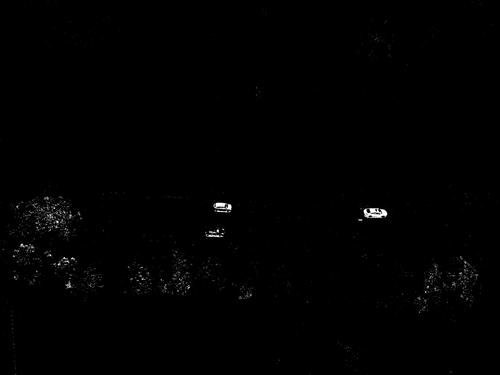

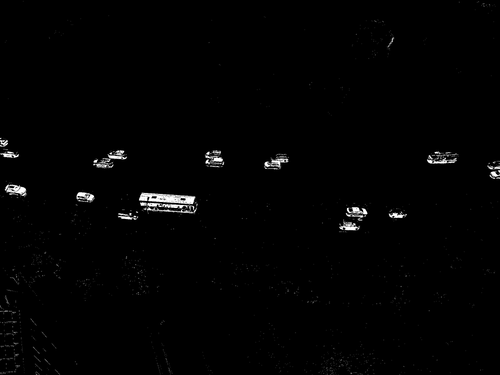

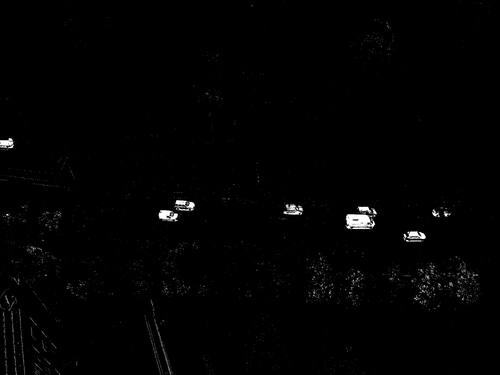

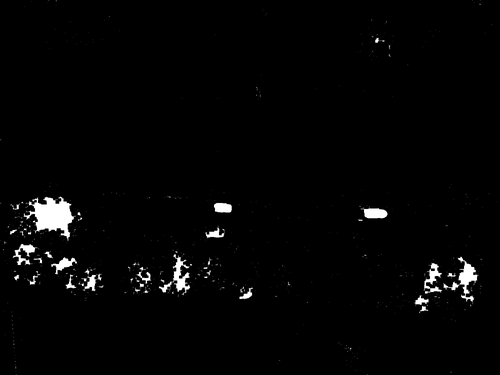

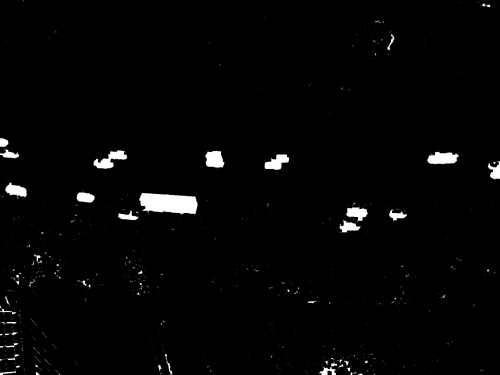

...

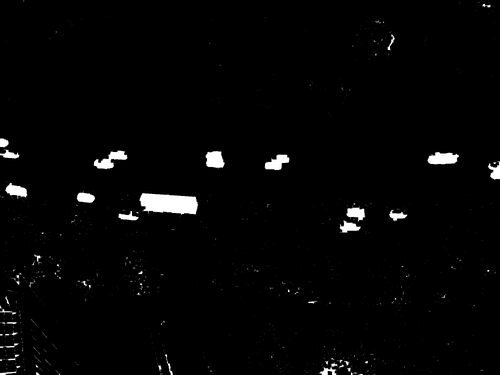

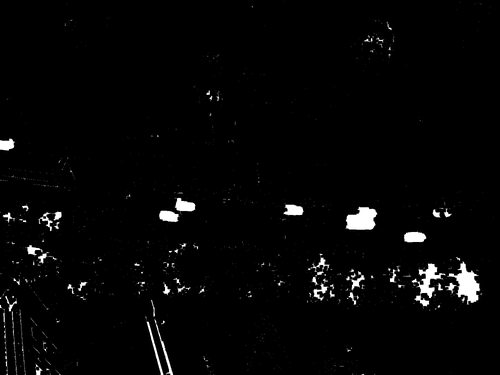

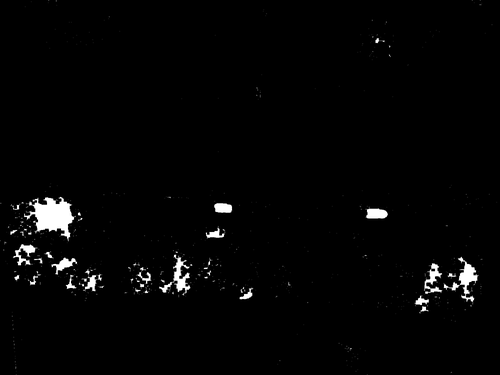

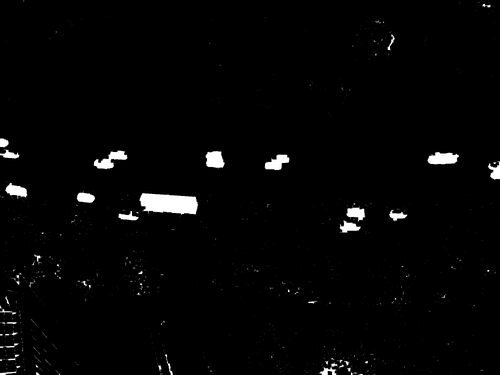

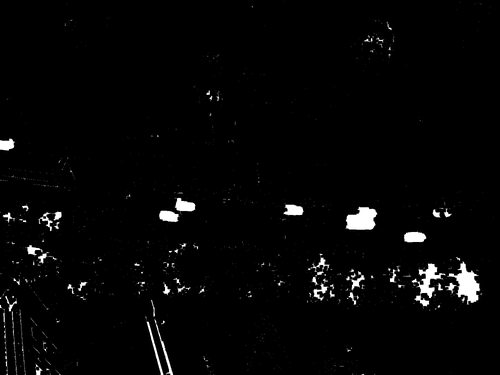

In [67]:
kernel = np.ones((10,10))
imshow(thresh1)
imshow(thresh2)
imshow(thresh3)

filled_images = []
filled_images2 = []

for img_ in [thresh1, thresh2, thresh3]:
    img_t = close(img_, kernel)
    contours, _ = cv2.findContours(img_t, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)


    filled_image = np.zeros_like(img_t)

    # Fill concave parts in the contours
    for contour in contours:
        cv2.drawContours(filled_image, [contour], 0, 255, -1)

    imshow(filled_image)
    filled_images.append(filled_image)
    filled_images2.append(filled_image)

filter_mask1 = filled_images[0].astype(np.bool_)
filter_mask2 = filled_images[1].astype(np.bool_)
filter_mask3 = filled_images[2].astype(np.bool_)

filled_images[0][filter_mask2 & filter_mask3] = 0
filled_images[1][filter_mask1 & filter_mask3] = 0
filled_images[2][filter_mask1 & filter_mask2] = 0


filled_images3 = list()
for img_ in filled_images:
    img_t = close(img_, kernel)
    contours, _ = cv2.findContours(img_t, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    filled_image = np.zeros_like(img_t)

    for contour in contours:
        cv2.drawContours(filled_image, [contour], 0, 255, -1)

    imshow(filled_image)
    filled_images3.append(filled_image)

filled_images = filled_images3

for im in filled_images:
    pass
    imshow(im)




In order for masks to properly cover the whole objects we take the extreme points and create a bounding box around them. The box is then dilated by few extra pixels to ensure it covers everything.

In [113]:
filled_images4 = list()
for _img in filled_images:
    _img = cv2.dilate(_img, np.ones((1,1)))
    filled_images4.append(_img)

In [114]:
filtered_images = list()
filtered_images2 = list()

for image in filled_images4:

    # Apply connected component analysis
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(image, connectivity=8)

    # Set a threshold for region size
    threshold_size = 100  # Adjust this threshold as needed

    # Iterate through the regions and filter based on size threshold
    filtered_regions = []
    for i in range(1, num_labels):  # Start from 1 to skip background (label 0)
        region_size = stats[i, cv2.CC_STAT_AREA]
        if region_size > threshold_size:
            filtered_regions.append(labels == i)

    # Visualize the filtered regions
    filtered_image = np.zeros_like(image)
    for region in filtered_regions:
        filtered_image |= region.astype(np.uint8) * 255


    # Find extreme points for each filtered region
    extreme_points_list = []
    for region in filtered_regions:
        contours, _ = cv2.findContours(region.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        if contours:
            contour = contours[0]
            extreme_points = np.squeeze(contour, axis=1)
            min_x = np.min(extreme_points[:, 0])
            min_y = np.min(extreme_points[:, 1])
            max_x = np.max(extreme_points[:, 0])
            max_y = np.max(extreme_points[:, 1])

            filtered_image[min_y:max_y, min_x:max_x] = 255

    # Display the resulting image
    filtered_images.append(filtered_image)
    filtered_images2.append(filtered_image)

mask1 = filtered_images[0].astype(np.bool_)
mask2 = filtered_images[1].astype(np.bool_)
mask3 = filtered_images[2].astype(np.bool_)

    
mask12 = mask1 & mask2
mask13 = mask1 & mask3
mask23 = mask2 & mask3

for i1, im1 in enumerate(filtered_images):
    for i2, im2 in enumerate([mask23, mask13, mask12]):
        if i1 != i2:
            pass
            #im1[im2.astype(np.bool_)] = 0



In [126]:
filtered_images1 = list()
for _img in filtered_images:
    _img = cv2.dilate(_img, np.ones((15,15)))
    filtered_images1.append(_img)

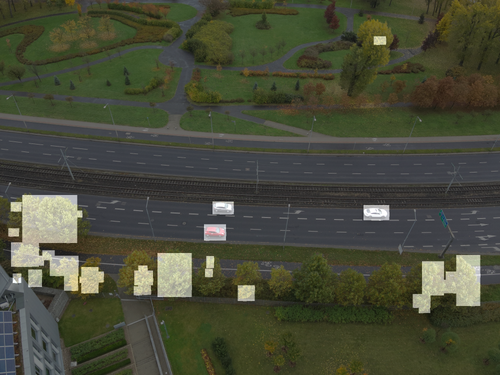

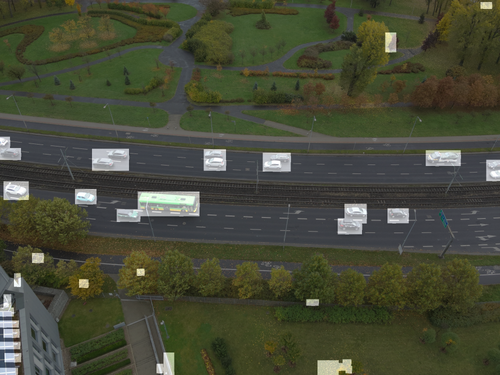

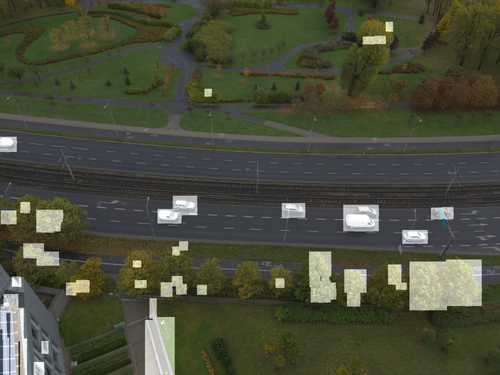

In [127]:
for img, binarized in zip([img1, img2, img3], filtered_images1):
    stack = np.stack((img, np.repeat(binarized[:,: ,np.newaxis], 3, axis=2)))

    imshow(np.average(stack, axis=0))

Masks obtained in the whole process are now combined with the images in the similar way as previously. No mask cover - median, one cover - average of 2 left, two covered - 1 left, all cover - use inpaint.

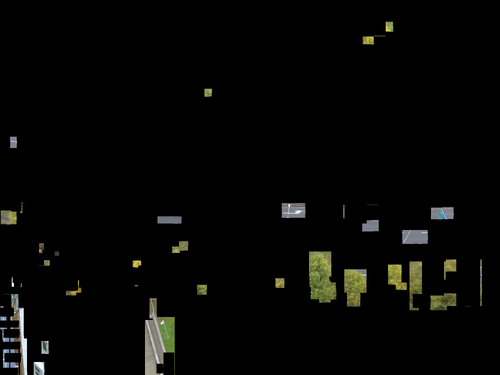

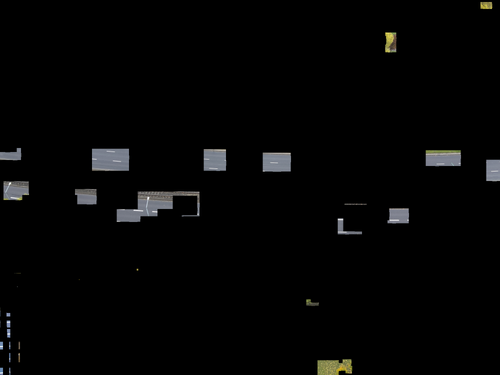

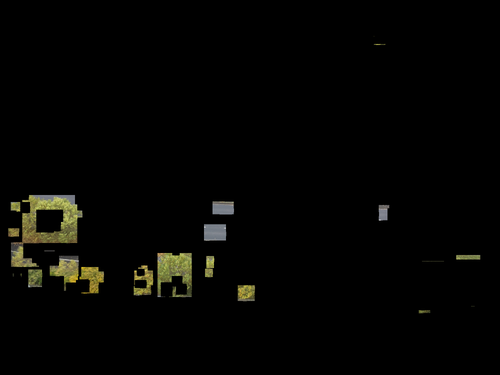

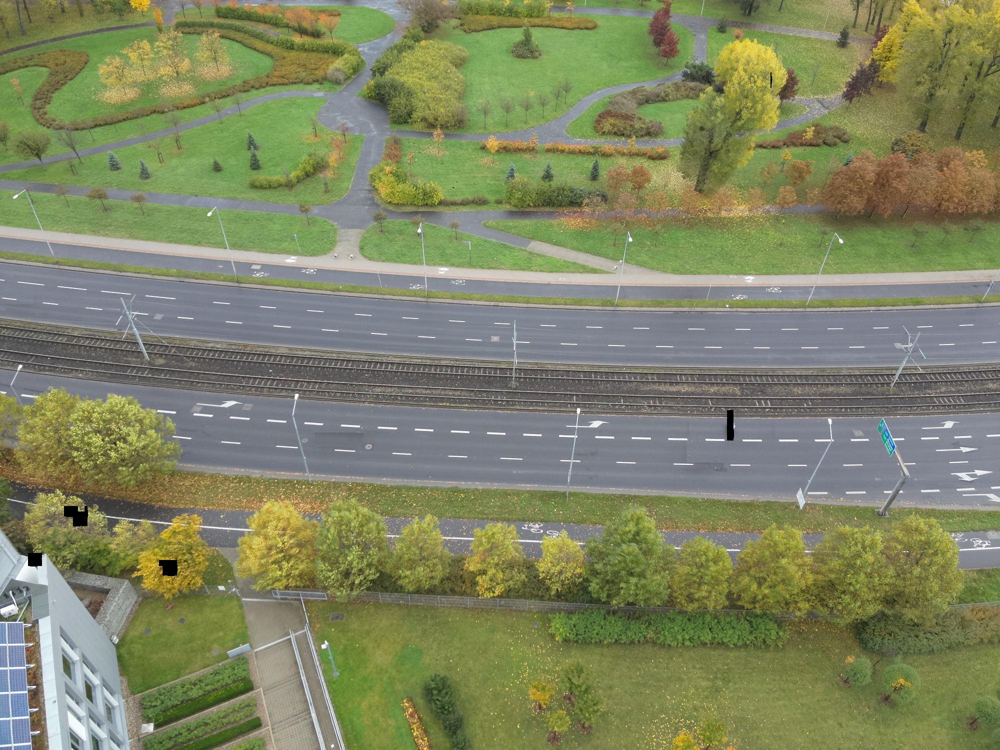

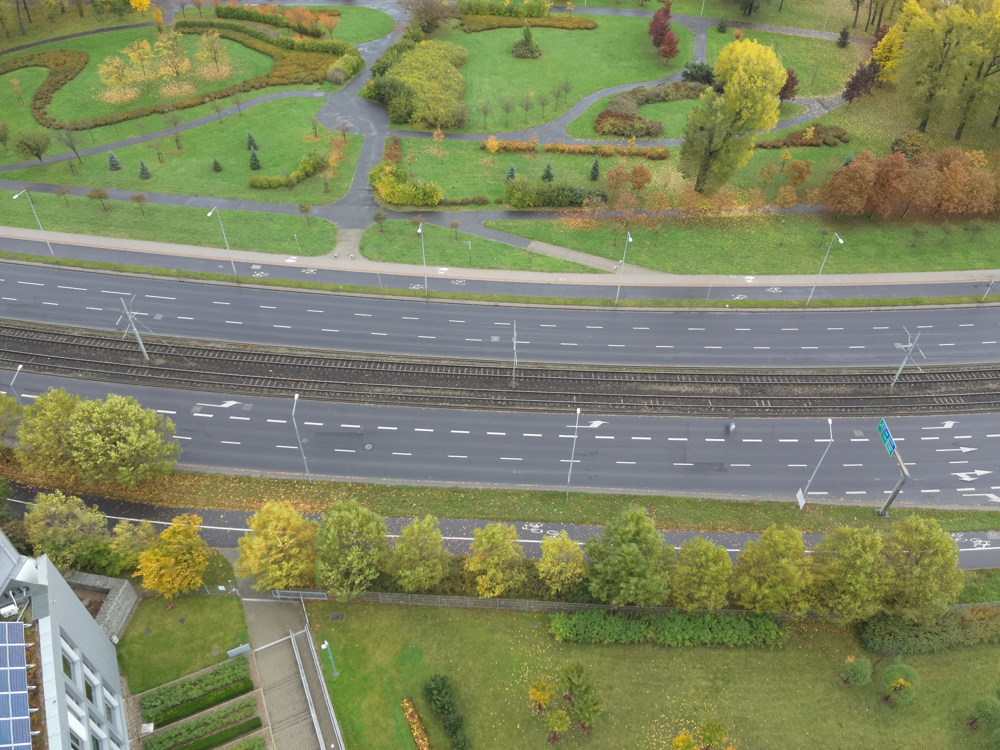

In [129]:

img1_modified = img1.copy()
img2_modified = img2.copy()
img3_modified = img3.copy()

img12_modified = np.stack((img1, img2))
img13_modified = np.stack((img1, img3))
img23_modified = np.stack((img2, img3))
img12_modified = np.median(img12_modified, axis=0)
img13_modified = np.median(img13_modified, axis=0)
img23_modified = np.median(img23_modified, axis=0)

img123_modified = np.stack((img1, img2, img3))
img123_modified = np.median(img123_modified, axis=0)

mask1 = filtered_images1[0].astype(np.bool_)
mask2 = filtered_images1[1].astype(np.bool_)
mask3 = filtered_images1[2].astype(np.bool_)


mask12 = mask1 & mask2
mask13 = mask1 & mask3
mask23 = mask2 & mask3

mask123 = mask12 & mask3

img1_modified[mask1 | ~mask2 | ~mask3] = 0
img2_modified[mask2 | ~mask1 | ~mask3] = 0
img3_modified[mask3 | ~mask1 | ~mask2] = 0
img12_modified[mask1 | mask2 | ~mask3] = 0
img13_modified[mask1 | ~mask2 | mask3] = 0
img23_modified[~mask1 | mask2 | mask3] = 0

img123_modified[(mask1 | mask2 | mask3) ] = 0

final = np.stack((img1_modified, img2_modified, img3_modified, img12_modified, img13_modified, img23_modified, img123_modified))
final = np.sum(final, axis=0)
imshow(img12_modified)
imshow(img13_modified)
imshow(img23_modified)
imshow1(final)

final = cv2.inpaint(final.astype(np.uint8), mask123.astype(np.uint8), 20, cv2.INPAINT_NS)
imshow1(final)

In [61]:
img1 = cv2.imread('DJI_20231031123737_0028_W.JPG')
img2 = cv2.imread('DJI_20231031123813_0040_W.JPG')
img3 = cv2.imread('DJI_20231031123834_0047_W.JPG')
img4 = cv2.imread('fnal1.jpg')
img5 = cv2.imread('fnal2.jpg')

We merge all previously obtained results and original images to get rid of even more impurities.

average:


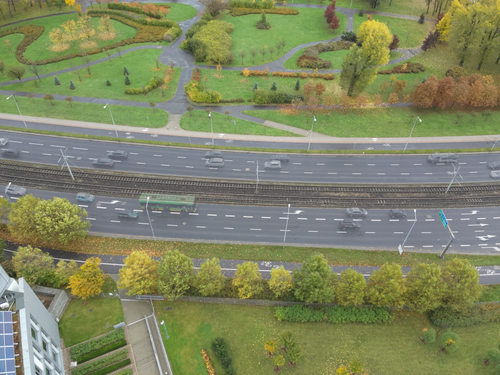

median:


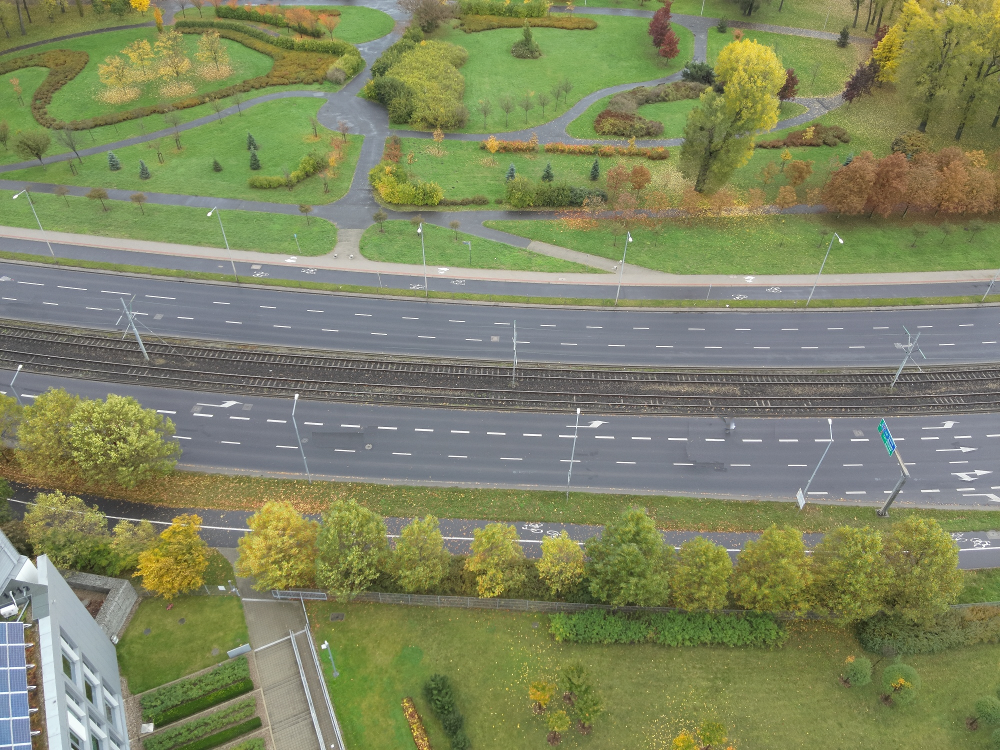

In [136]:
stacked_img = np.stack((img2, img4, final))
average_img = np.average(stacked_img, axis=0)
median_img = np.median(stacked_img, axis=0)
print("average:")
imshow(average_img)
print("median:")
imshow1(median_img)